In [1]:
import sys,os
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt 
import seaborn as sns
from IPython.display import HTML
from IPython.display import Image
matplotlib.rc("savefig", dpi=1000)
%matplotlib inline

**Data extraction and cleaning**

In [31]:
def filter_lat_lng(d,city):
    
    if city == 'SF':
        d=d[d.X != -120.5]
        d=d[d.X < -122.37]
        d=d[d.X > -122.51]
        
    elif city == 'NY':
        
        d=d[d.Y < 40.9128687953]
        d=d[d.Y > 39.5525551789]
        d=d[d.X < -73.254532] 
        d=d[d.X > -74.254532]   
        
    return d
    
def extract_category(d,field,cat,city):
        
    d=pd.DataFrame(d[d[field]==cat])
    
    d=filter_lat_lng(d,city)
    
    return d

def plt_data(d,color,year,size,a):
    
    f1=plt.figure(figsize=(7,7),dpi=600,facecolor='black')
    ax = f1.add_subplot(1, 1, 1)
    plt.scatter(d.X,d.Y,c=color,s=size,alpha=a,edgecolor='') 
    # plt.text(0.1, 0.9,year,ha='center',va='center',color='w',transform=ax.transAxes)
    plt.axis('off')
    plt.show()

def plt_maps_ts(d,c,a,size):
     
    d['year']=pd.DatetimeIndex(d.Date).year
    f1=plt.figure(figsize=(10,10),dpi=600,facecolor='black')
    
    for i,year in enumerate(sorted(d.year.unique())):
    
        yr_data = d[d.year == year]
        ax = f1.add_subplot(4,4, i+1)
        plt.scatter(yr_data.X,yr_data.Y,c=c,s=size,alpha=a,edgecolor='') 
        plt.text(0.1, 0.9,year,ha='center',va='center',color='w',transform=ax.transAxes)
        plt.axis('off')
        
def plt_maps_ts_month(d,c,a,size):
     
    d['month']=pd.DatetimeIndex(d.Date).month
    f1=plt.figure(figsize=(10,10),dpi=600,facecolor='black')
    
    for i,month in enumerate(sorted(d.month.unique())):
    
        m_data = d[d.month == month]
        ax = f1.add_subplot(4,4, i+1)
        plt.scatter(m_data.X,m_data.Y,c=c,s=size,alpha=a,edgecolor='') 
        plt.text(0.1, 0.9,month,ha='center',va='center',color='w',transform=ax.transAxes)
        plt.axis('off')
        
def get_data(d_set_name):
    
    d=pd.read_csv(os.getcwd()+'/data/%s'%d_set_name)
    return d
    
def plt_hotspots(d,s,a,t1,t2,t3,bg):

    top_locations = d.groupby('Address').size().sort_values()
    tier1=top_locations[top_locations >= t1]
    tier2=top_locations[(top_locations < t1) & (top_locations >= t2)]
    tier3=top_locations[(top_locations < t2) & (top_locations >= t3)]
    tier4=top_locations[top_locations < t3]

    f1=plt.figure(figsize=(7.5,7.5),dpi=600,facecolor='black')
    for locs,c,size in zip(reversed([tier1,tier2,tier3,tier4]),
                           reversed(['r','y','g',bg]),
                           reversed([s,s,s,s])):

        d_plt = d[d.Address.isin(list(locs.index))]
        ax = f1.add_subplot(1,1,1)
        plt.scatter(d_plt.X,d_plt.Y,c=c,s=size,alpha=a,edgecolor='') 
        plt.axis('off')
        
def plt_by_type(d,s,a,c1,c2,c3,c4,agg):
    
    if agg:
        
        tier1=d[d.Descriptor == c1]
        tier_else=d[d.Descriptor != c1]
        
        f1=plt.figure(figsize=(7.5,7.5),dpi=600,facecolor='black')
        for d_plt,c,size in zip(reversed([tier1,tier_else]),
                               reversed(['r','g']),
                               reversed([s,s])):

            ax = f1.add_subplot(1,1,1)
            plt.scatter(d_plt.X,d_plt.Y,c=c,s=size,alpha=a,edgecolor='') 
            plt.axis('off')
            
    else:
        
        tier1=d[d.Descriptor == c1]
        tier2=d[d.Descriptor == c2]
        tier3=d[d.Descriptor == c3]
        tier4=d[d.Descriptor == c4]

        f1=plt.figure(figsize=(7.5,7.5),dpi=600,facecolor='black')
        for d_plt,c,size in zip(reversed([tier1,tier2,tier3,tier4]),
                               # reversed(['r','m','y','g']),
                               reversed(['r','r','r','c']),
                               reversed([s,s,s,s])):

            ax = f1.add_subplot(1,1,1)
            plt.scatter(d_plt.X,d_plt.Y,c=c,s=size,alpha=a,edgecolor='') 
            plt.axis('off')
            
def plt_maps_hour_cat(d,s,a,c1,c2,c3,c4):
     
    d['hour']=pd.DatetimeIndex(d.Date).hourofday
    f1=plt.figure(figsize=(10,10),dpi=600,facecolor='black')
    
    for i,hour in enumerate(sorted(d.hour.unique())):
    
        d = d[d.year == hour]
        
        tier1=d[d.Descriptor == c1]
        tier2=d[d.Descriptor == c2]
        tier3=d[d.Descriptor == c3]
        tier4=d[d.Descriptor == c4]
        
        for d_plt,c,size in zip(reversed([tier1,tier2,tier3,tier4]),
                               reversed(['r','m','y','g']),
                               reversed([s,s,s,s])):
            
            ax = f1.add_subplot(5,5, i+1)
            plt.scatter(d_plt.X,d_plt.Y,c=c,s=size,alpha=a,edgecolor='') 
        
        plt.text(0.1, 0.9,hour,ha='center',va='center',color='w',transform=ax.transAxes)
        plt.axis('off')

In [ ]:
sf_crime = get_data('Map_of_Police_Department_Incidents.csv')
ny_311 = get_data('311_Service_Requests_from_2010_to_Present.csv')
ny_rodents = get_data('Rodent_Inspection.csv')
ny_crashes = get_data('NYPD_Motor_Vehicle_Collisions.csv')
sf_311 = get_data('311_Cases.csv')

**311 data**

In [47]:
sf_311['Y']=sf_311['Latitude']
sf_311['X']=sf_311['Longitude']
sf_311['Date']=sf_311['Opened']
sf_311.groupby('Category').size().sort_values().tail(10)

Category
Streetlights                     61830
SFHA Requests                    67445
Sewer Issues                     71859
Damaged Property                 86956
Encampments                      93828
Homeless Concerns               132338
Abandoned Vehicle               171841
MUNI Feedback                   183157
Graffiti                        402241
Street and Sidewalk Cleaning    729323
dtype: int64

In [38]:
ny_311['Y']=ny_311['Latitude']
ny_311['X']=ny_311['Longitude']
ny_311['Address']=ny_311['Incident Address']
ny_311['Date']=ny_311['Created Date']
ny_311.groupby('Complaint Type').size().sort_values().tail(10)

Complaint Type
GENERAL CONSTRUCTION       500863
Water System               502165
Illegal Parking            540887
PLUMBING                   614201
Blocked Driveway           629970
HEAT/HOT WATER             744340
Street Light Condition     762705
Street Condition           766674
HEATING                    887869
Noise - Residential       1337264
dtype: int64

**SF graffiti**

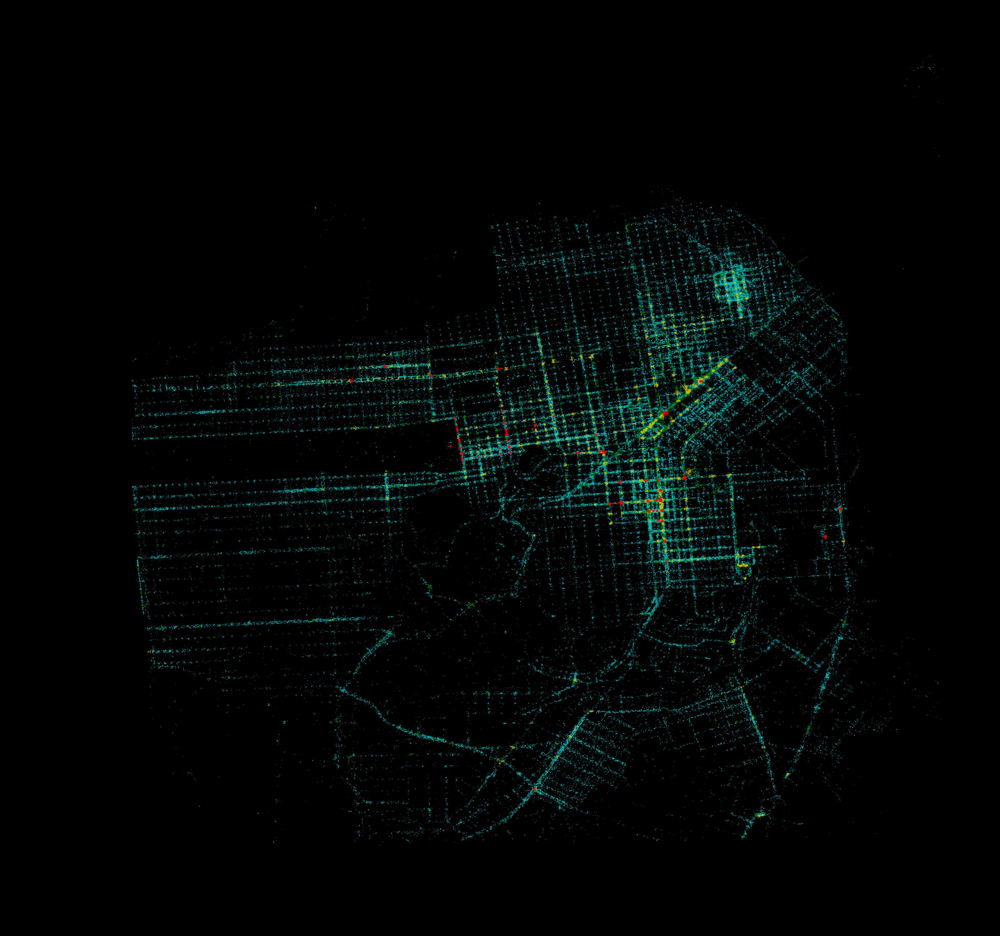

In [37]:
s=0.15
a=0.35
t1 = 250
t2 = 100
t3 = 50
sf_graffiti = extract_category(sf_311,'Category','Graffiti','SF')
plt_hotspots(sf_graffiti,s,a,t1,t2,t3,'c')

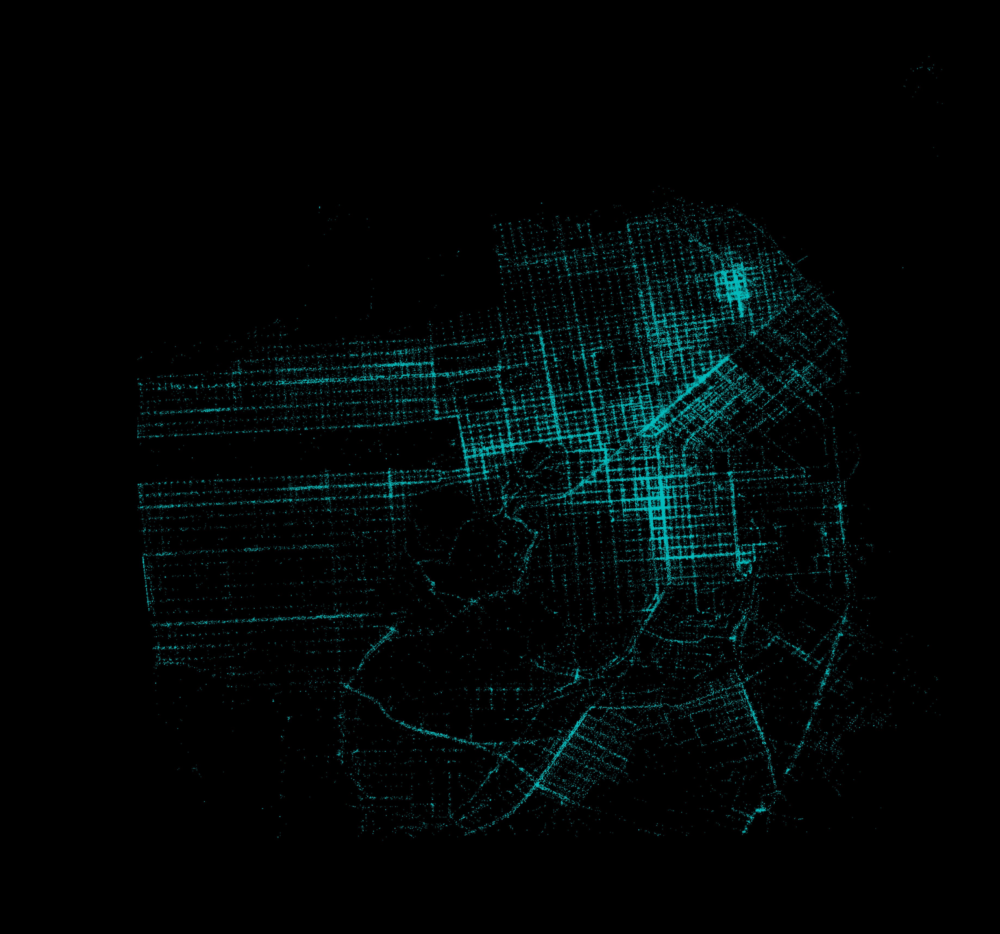

In [40]:
s=0.15
a=0.35
plt_data(sf_graffiti,'c','2003-2017',s,a)

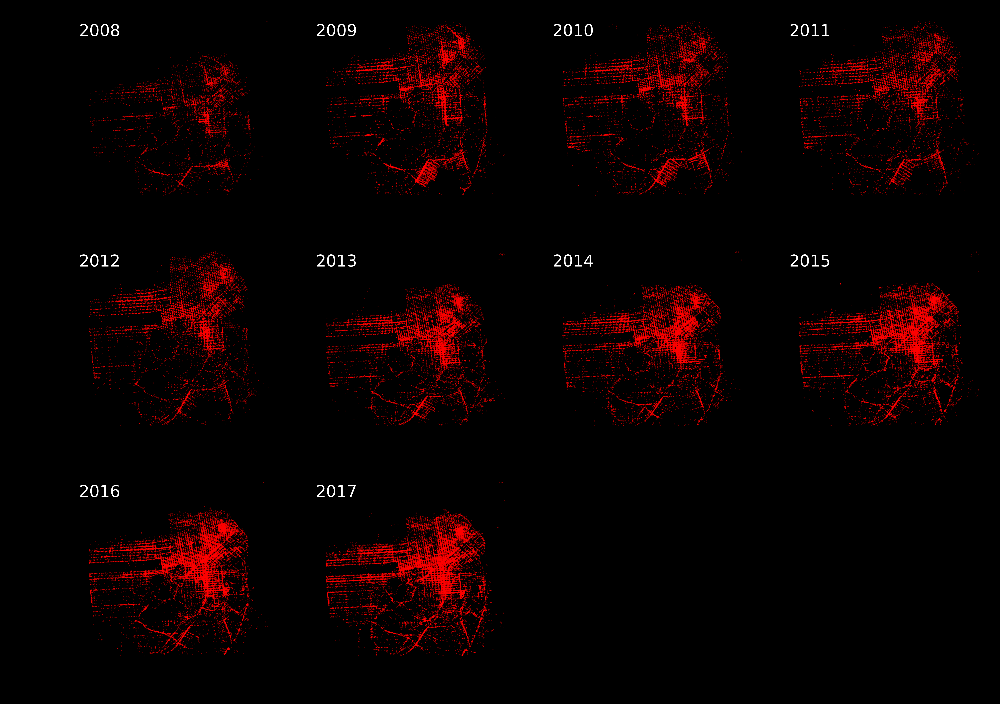

In [41]:
s=0.35
a=0.35
plt_maps_ts(sf_graffiti,'r',a,s)

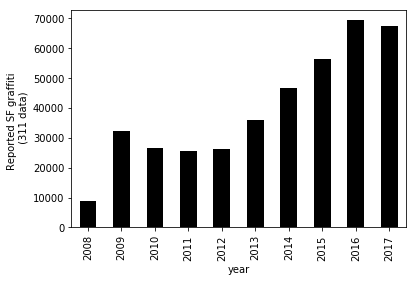

In [42]:
sf_graffiti.groupby('year').size().plot(kind='bar',color='k')
plt.ylabel('Reported SF graffiti \n (311 data)')

**SF and NY homeless encampments**

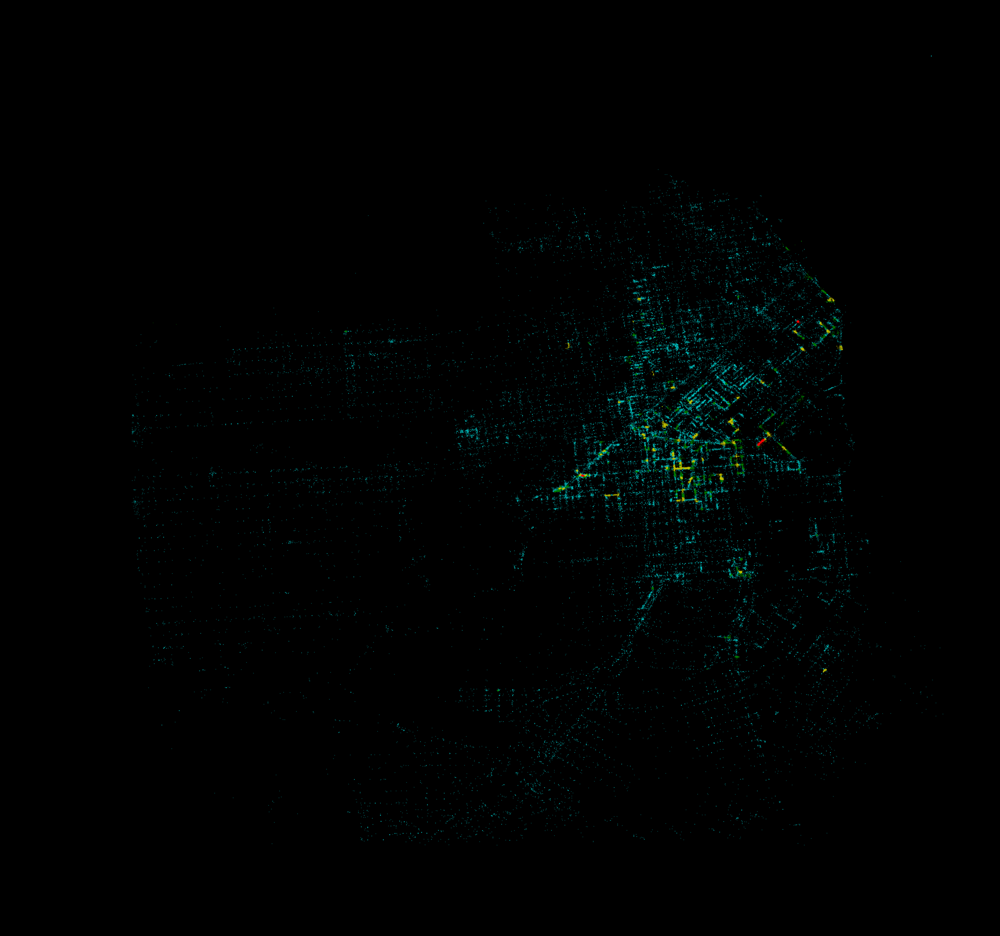

In [22]:
s=0.15
a=0.35
t1 = 250
t2 = 100
t3 = 50
sf_encampments = extract_category(sf_311,'Category','Encampments','SF')
plt_hotspots(sf_encampments,s,a,t1,t2,t3,'c')

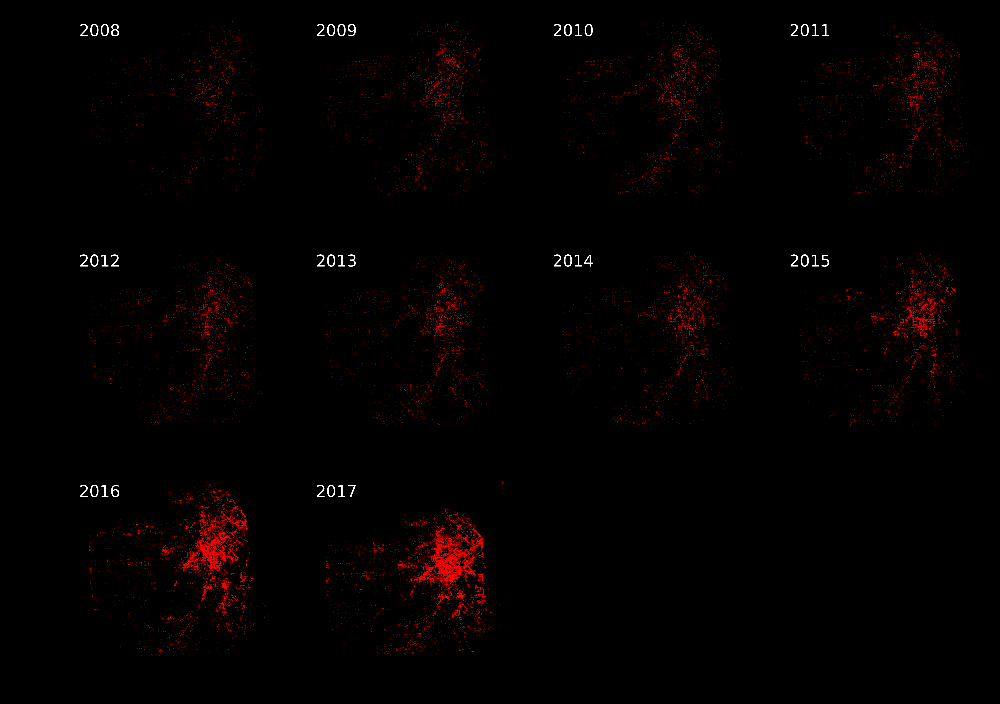

In [28]:
s=0.35
a=0.35
plt_maps_ts(sf_encampments,'r',a,s)

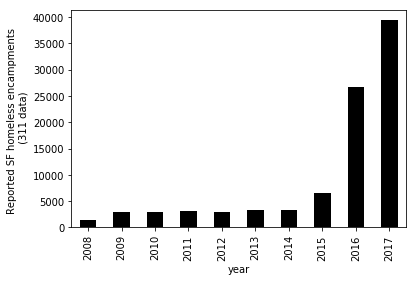

In [35]:
sf_encampments.groupby('year').size().plot(kind='bar',color='k')
plt.ylabel('Reported SF homeless encampments \n (311 data)')

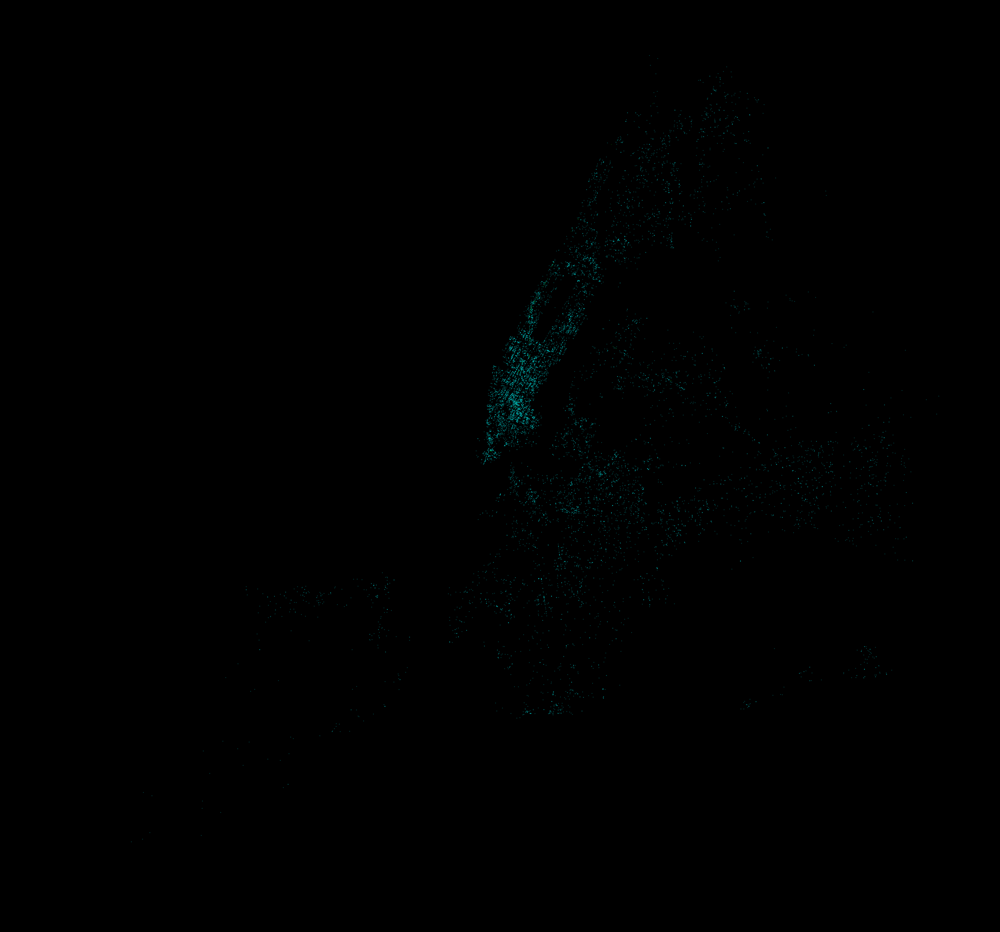

In [17]:
s=0.15
a=0.35
t1 = 250
t2 = 100
t3 = 50
ny_encampments = extract_category(ny_311,'Complaint Type','Homeless Encampment','NY')
plt_hotspots(ny_encampments,s,a,t1,t2,t3,'c')

**SF auto theft**

In [48]:
sf_crime.groupby('Category').size().sort_values().tail(10)

Category
SUSPICIOUS OCC     76618
BURGLARY           87198
WARRANTS           97789
VANDALISM         109830
DRUG/NARCOTIC     117013
VEHICLE THEFT     123210
ASSAULT           184946
NON-CRIMINAL      226434
OTHER OFFENSES    297175
LARCENY/THEFT     447992
dtype: int64

In [55]:
sf_theft = extract_category(sf_crime,'Category','LARCENY/THEFT','SF')
print sf_theft.groupby('Descript').size().sort_values().tail(10)
sf_auto_theft = pd.DataFrame(sf_theft[sf_theft.Descript.str.contains('AUTO')])

Descript
GRAND THEFT PICKPOCKET             13094
GRAND THEFT FROM UNLOCKED AUTO     13402
GRAND THEFT FROM PERSON            17179
GRAND THEFT FROM A BUILDING        21631
PETTY THEFT SHOPLIFTING            23237
PETTY THEFT FROM A BUILDING        24398
GRAND THEFT OF PROPERTY            27234
PETTY THEFT OF PROPERTY            42277
PETTY THEFT FROM LOCKED AUTO       48824
GRAND THEFT FROM LOCKED AUTO      161760
dtype: int64


In [52]:
sf_auto_theft.groupby('Address').size().sort_values().tail(10)

Address
5TH ST / MISSION ST              487
1300 Block of WEBSTER ST         524
GEARY BL / WEBSTER ST            554
400 Block of STOCKTON ST         599
GEARY BL / LAGUNA ST             613
3200 Block of 20TH AV            621
3600 Block of LYON ST            720
800 Block of MISSION ST          827
500 Block of JOHNFKENNEDY DR    1630
800 Block of BRYANT ST          9628
dtype: int64

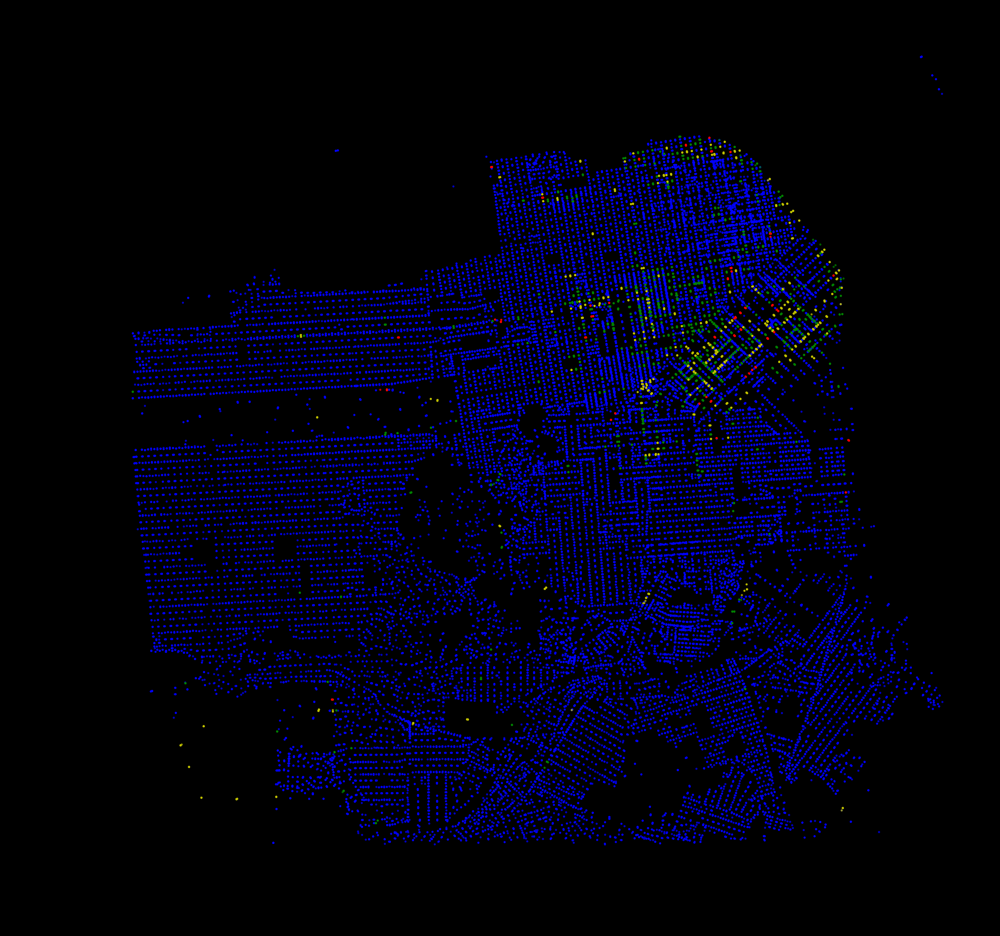

In [328]:
s=1.0
a=0.75
t1 = 250
t2 = 100
t3 = 50
plt_hotspots(sf_auto_theft,s,a,t1,t2,t3,'b')

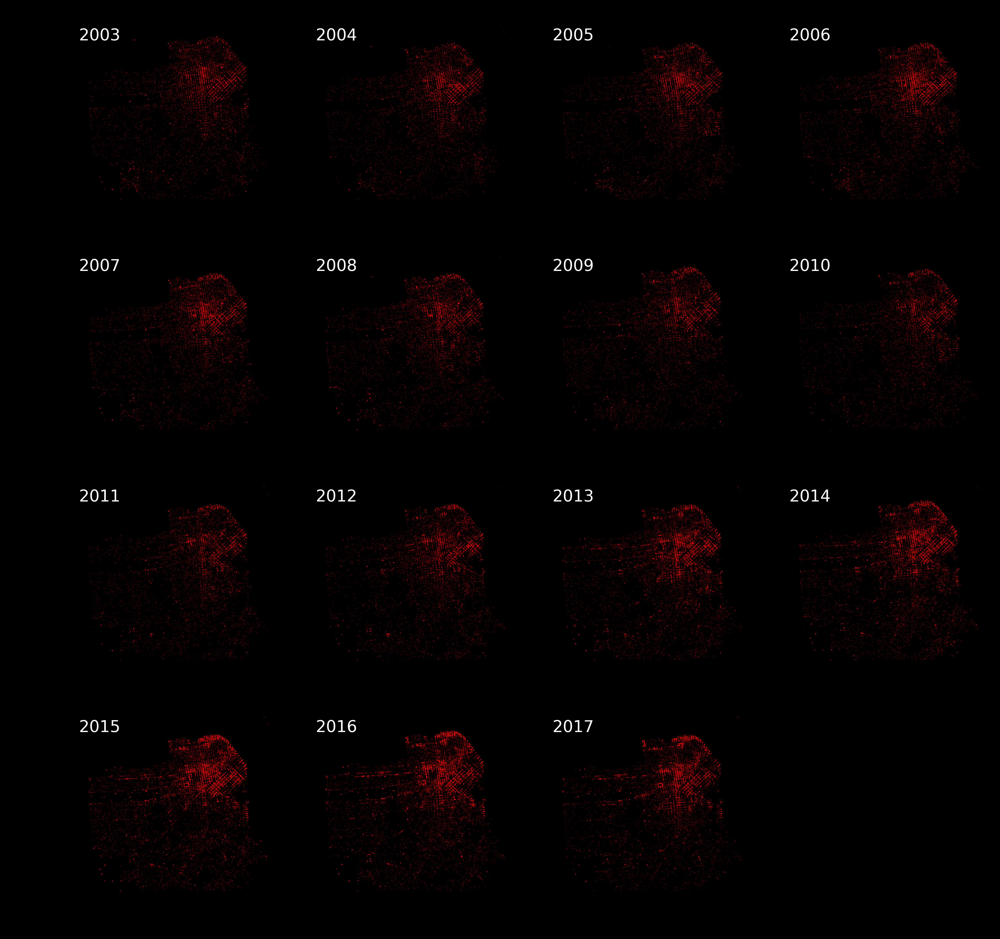

In [50]:
s=0.35
a=0.15
plt_maps_ts(sf_auto_theft,'r',a,s)

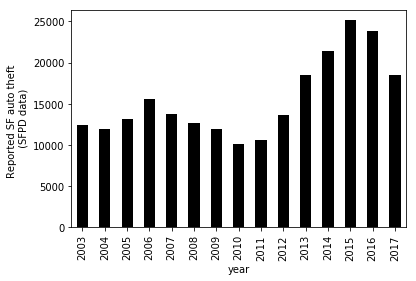

In [49]:
sf_auto_theft.groupby('year').size().plot(kind='bar',color='k')
plt.ylabel('Reported SF auto theft \n (SFPD data)')

**NY Crashes**

In [183]:
ny_crashes['Y']=ny_crashes['LATITUDE']
ny_crashes['X']=ny_crashes['LONGITUDE']
ny_crashes['Date']=ny_crashes['DATE']
ny_crashes['Address']=ny_crashes['OFF STREET NAME'].astype(str)+ny_crashes['ON STREET NAME'].astype(str)
ny_crashes['Address'] = ny_crashes['LOCATION']
ny_crashes=filter_lat_lng(ny_crashes,'NY')

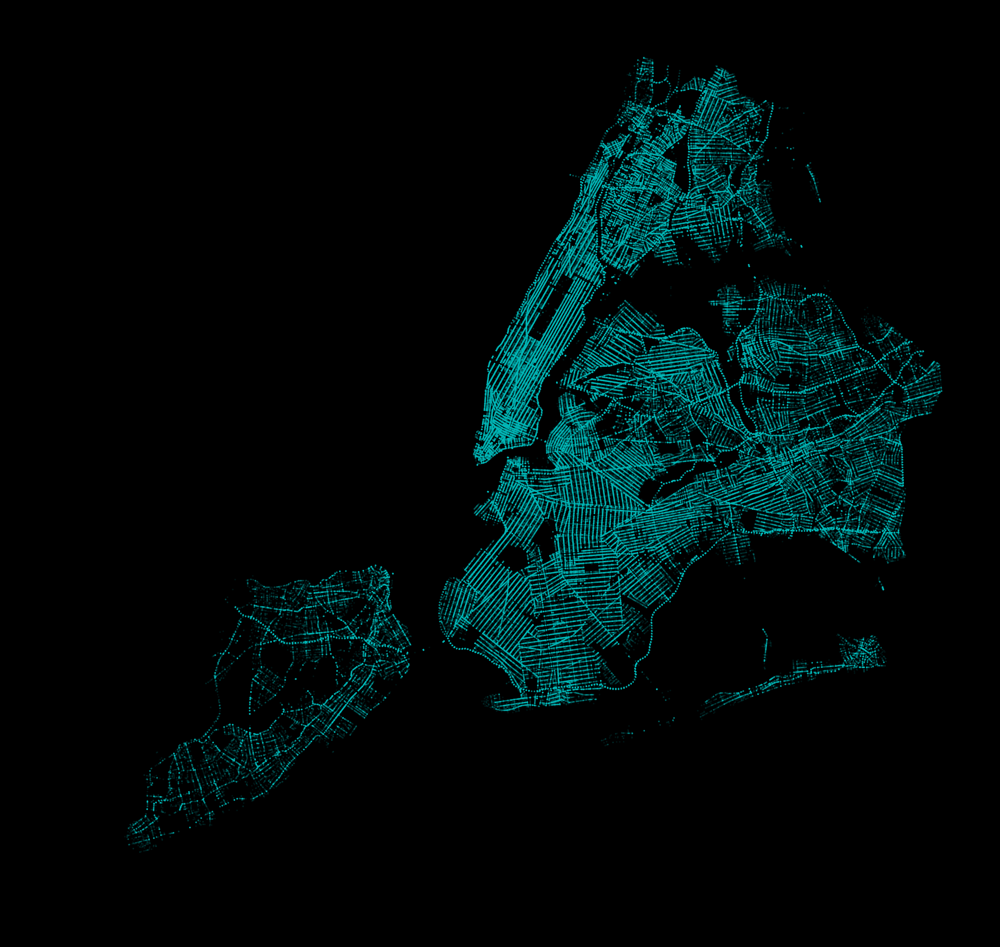

In [186]:
s=0.5
a=0.1
plt_data(ny_crashes,'c','2003-2017',s,a)

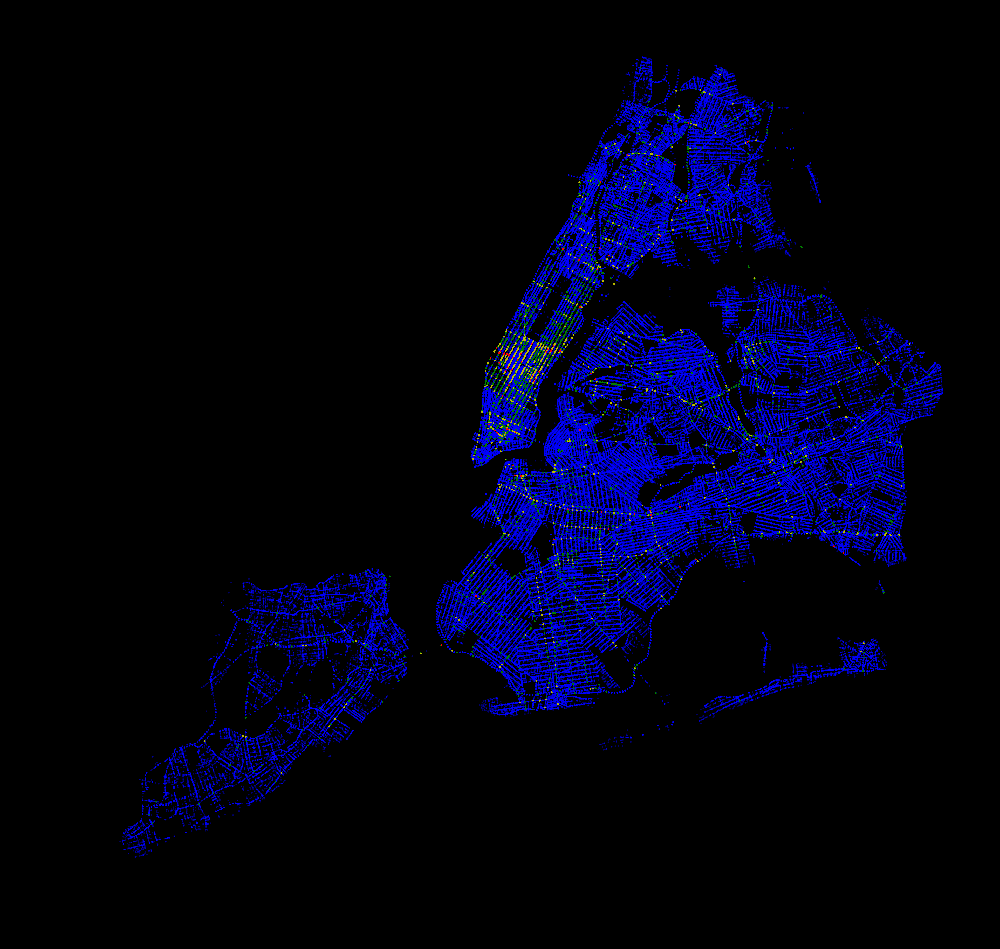

In [332]:
s=0.5
a=0.4
t1 = 250
t2 = 100
t3 = 50
plt_hotspots(ny_crashes,s,a,t1,t2,t3,'b')

**NY Noise**

In [58]:
ny_noise.shape

(2452298, 57)

In [49]:
ny_noise=pd.DatFrame(ny_311[ny_311['Complaint Type'].str.contains('Noise')])
ny_noise.groupby('Descriptor').size().sort_values().tail(10)

Descriptor
Noise: Jack Hammering (NC2)                       25587
Car/Truck Horn                                    28013
Engine Idling                                     36993
Noise: Construction Equipment (NC1)               49446
Noise, Barking Dog (NR5)                          54566
Car/Truck Music                                   83608
Noise: Construction Before/After Hours (NM1)     142412
Loud Talking                                     224132
Banging/Pounding                                 369045
Loud Music/Party                                1301572
dtype: int64

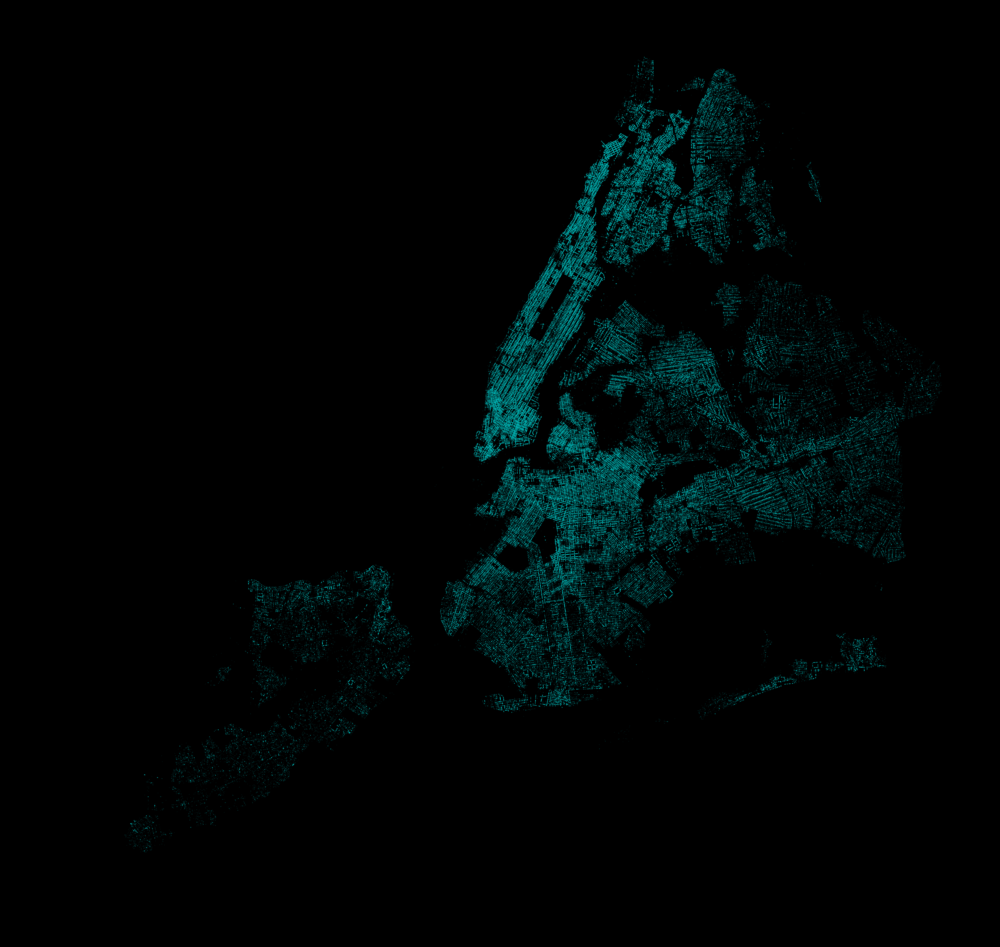

In [59]:
s=0.1
a=0.1
plt_data(ny_noise,'c','2003-2017',s,a)

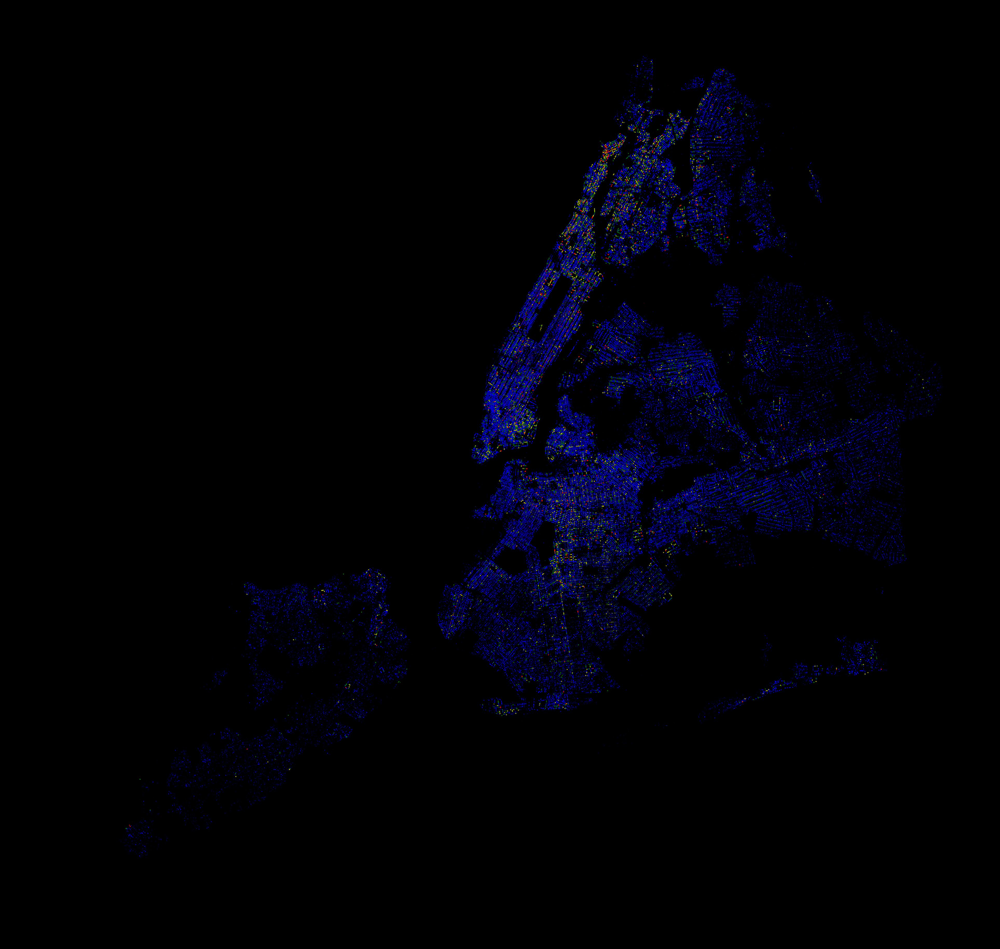

In [57]:
s=0.15
a=0.1
t1 = 250
t2 = 100
t3 = 50
plt_hotspots(ny_noise,s,a,t1,t2,t3,'b')

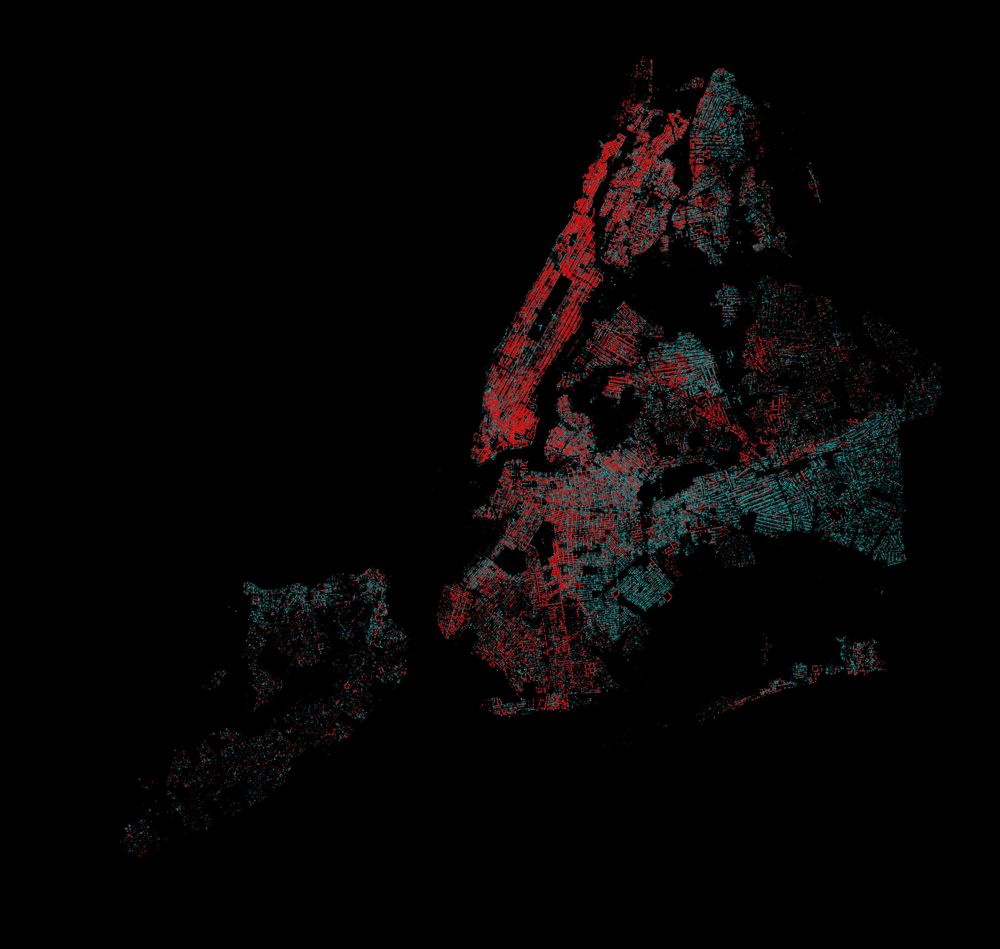

In [32]:
s=0.25
a=0.15
c4='Loud Television'
c3='Loud Talking'
c2='Banging/Pounding'
c1='Loud Music/Party'
plt_by_type(ny_noise,s,a,c4,c3,c2,c1,False)

In [ ]:
plt_maps_hour_cat(noise,s,a,c1,c2,c3,c4)

**NY Rodents**

In [57]:
ny_rodents['Y']=ny_rodents['LATITUDE']
ny_rodents['X']=ny_rodents['LONGITUDE']
ny_rodents['Date']=ny_rodents['APPROVED_DATE']
ny_rodents['Address']=ny_rodents['HOUSE_NUMBER'].astype(str)+ny_rodents['STREET_NAME'].astype(str)
ny_rodents['Address']=ny_rodents['LOCATION']
ny_rodents['Descriptor']=ny_rodents['RESULT']
ny_rodents=filter_lat_lng(ny_rodents,'NY')
print ny_rodents.groupby('Descriptor').size().sort_values()

Descriptor
Cleanup done            1189
Monitoring visit       21802
Problem Conditions    144383
Active Rat Signs      158492
Bait applied          169441
Passed Inspection     804668
dtype: int64


In [59]:
s=0.35
a=0.15
t1 = 15
t2 = 10
t3 = 5
active = pd.DataFrame(ny_rodents[ny_rodents.RESULT == 'Active Rat Signs'])
#plt_data(active,'c','2003-2017',s,a)
#plt_hotspots(active,s,a,t1,t2,t3)
#plt_maps_ts(active,'r',a,s)
#plt_maps_ts_month(active,'r',a,s)

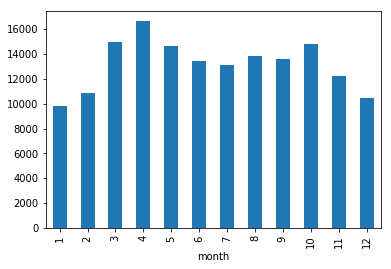

In [83]:
active.groupby('month').size().plot(kind='bar')

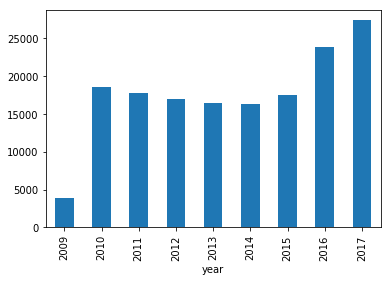

In [76]:
active.groupby('year').size().plot(kind='bar')

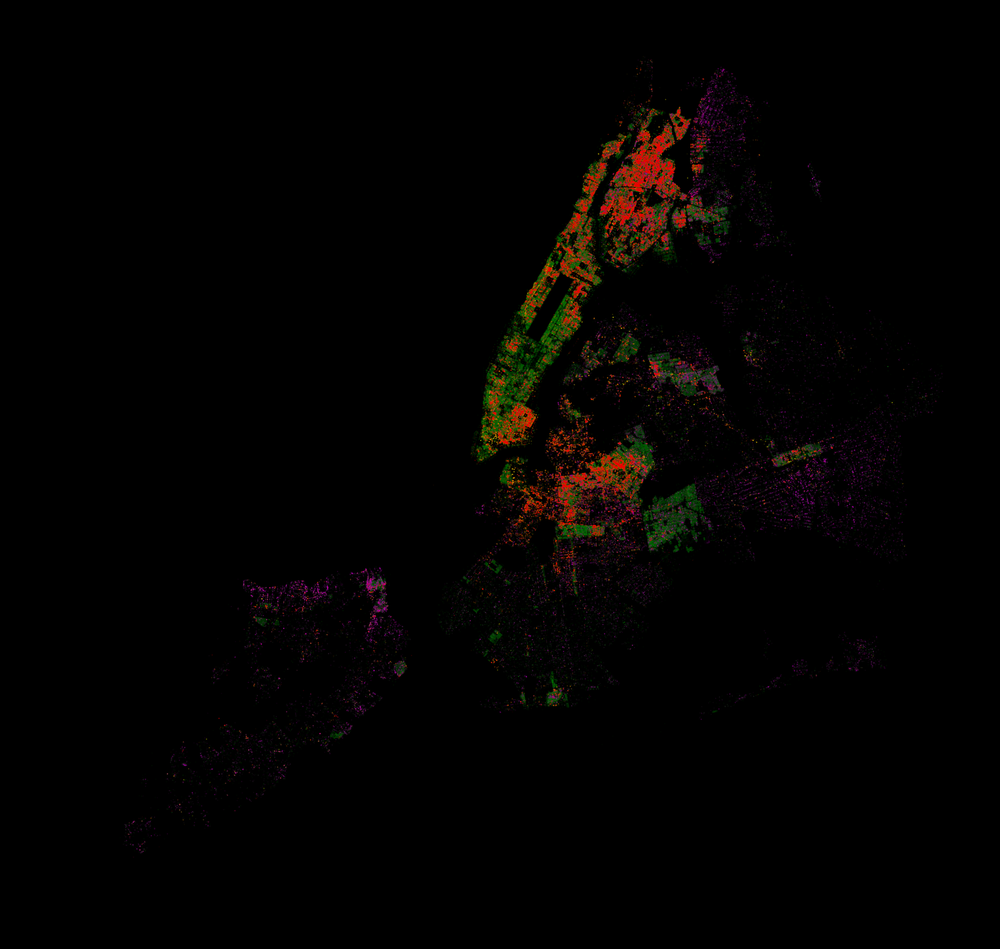

In [310]:
s=0.35
a=0.05
c4='Passed Inspection'
c3='Bait applied'
c2='Problem Conditions'
c1='Active Rat Signs'
plt_by_type(ny_rodents,s,a,c1,c2,c3,c4,False)